In [1]:
import requests
import pandas as pd
import sys, json
import json
import string
import datetime as dt
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

url="https://archive.org/advancedsearch.php?q=pneumonia+AND+wuhan&output=json&rows=50000"

In [2]:
response = requests.get(url).json()

In [3]:
response

{'responseHeader': {'status': 0,
  'QTime': 402,
  'params': {'query': '( (title:pneumonia^100 OR salients:pneumonia^50 OR subject:pneumonia^25 OR description:pneumonia^15 OR collection:pneumonia^10 OR language:pneumonia^10 OR text:pneumonia^1) AND (title:China^100 OR salients:China^50 OR subject:China^25 OR description:China^15 OR collection:China^10 OR language:China^10 OR text:China^1) )',
   'qin': 'pneumonia AND China',
   'fields': '_default_',
   'wt': 'json',
   'rows': '50000',
   'start': 0}},
 'response': {'numFound': 586,
  'start': 0,
  'docs': [{'backup_location': 'ia906601_18',
    'collection': ['Radio-KSJD-91-5-FM',
     'stream_only',
     'radio',
     'radioprograms'],
    'contributor': 'KSJD 91.5 FM',
    'coverage': ['US', 'US-CO'],
    'date': '2017-11-27T00:00:00Z',
    'downloads': 4,
    'format': ['ASR',
     'Columbia Peaks',
     'Item Tile',
     'JSON SRT',
     'Metadata',
     'Ogg Vorbis',
     'PNG',
     'Spectrogram',
     'Speech Confidence JSON',

In [4]:
response['response']['docs'][1]['date']

'2019-11-23T00:00:00Z'

In [5]:
dates = [""]*9999
for count,row in enumerate(response['response']['docs']):
    try:
        dates[count]=row['publicdate']
    except:
        try:
            dates[count]=row['date']
        except:
            pass


In [6]:
dates

['2017-11-27T14:26:47Z',
 '2019-11-23T10:10:04Z',
 '2017-05-04T01:15:55Z',
 '2019-09-02T04:05:19Z',
 '2020-03-21T18:05:22Z',
 '2017-08-31T07:22:20Z',
 '2020-03-18T13:04:49Z',
 '2019-05-19T21:17:05Z',
 '2019-05-19T21:16:07Z',
 '2020-06-29T13:09:30Z',
 '2019-04-23T15:39:58Z',
 '2019-09-05T23:19:07Z',
 '2019-11-11T19:08:47Z',
 '2019-08-26T03:02:09Z',
 '2014-10-21T20:54:30Z',
 '2020-05-25T09:07:06Z',
 '2020-10-10T21:16:27Z',
 '2018-02-28T19:51:44Z',
 '2020-05-02T04:04:11Z',
 '2020-05-16T09:27:22Z',
 '2019-07-06T20:05:31Z',
 '2020-05-02T16:12:01Z',
 '2020-03-24T09:01:42Z',
 '2014-10-04T18:04:28Z',
 '2021-09-14T14:37:33Z',
 '2019-12-15T03:12:18Z',
 '2021-08-18T10:39:39Z',
 '2018-02-28T21:34:10Z',
 '2014-12-30T03:15:36Z',
 '2020-07-21T12:48:08Z',
 '2019-04-23T17:55:19Z',
 '2020-06-28T23:29:33Z',
 '2019-01-22T19:23:56Z',
 '2020-10-20T19:02:51Z',
 '2020-05-02T06:09:49Z',
 '2019-08-26T00:04:45Z',
 '2017-08-27T15:32:50Z',
 '2019-02-10T20:29:15Z',
 '2018-08-13T17:15:20Z',
 '2017-10-02T10:23:59Z',


In [7]:
dates = [x for x in dates if x]

In [8]:
dates = [x for x in dates if str(dates[0]) != "0"]

In [9]:
dates

['2017-11-27T14:26:47Z',
 '2019-11-23T10:10:04Z',
 '2017-05-04T01:15:55Z',
 '2019-09-02T04:05:19Z',
 '2020-03-21T18:05:22Z',
 '2017-08-31T07:22:20Z',
 '2020-03-18T13:04:49Z',
 '2019-05-19T21:17:05Z',
 '2019-05-19T21:16:07Z',
 '2020-06-29T13:09:30Z',
 '2019-04-23T15:39:58Z',
 '2019-09-05T23:19:07Z',
 '2019-11-11T19:08:47Z',
 '2019-08-26T03:02:09Z',
 '2014-10-21T20:54:30Z',
 '2020-05-25T09:07:06Z',
 '2020-10-10T21:16:27Z',
 '2018-02-28T19:51:44Z',
 '2020-05-02T04:04:11Z',
 '2020-05-16T09:27:22Z',
 '2019-07-06T20:05:31Z',
 '2020-05-02T16:12:01Z',
 '2020-03-24T09:01:42Z',
 '2014-10-04T18:04:28Z',
 '2021-09-14T14:37:33Z',
 '2019-12-15T03:12:18Z',
 '2021-08-18T10:39:39Z',
 '2018-02-28T21:34:10Z',
 '2014-12-30T03:15:36Z',
 '2020-07-21T12:48:08Z',
 '2019-04-23T17:55:19Z',
 '2020-06-28T23:29:33Z',
 '2019-01-22T19:23:56Z',
 '2020-10-20T19:02:51Z',
 '2020-05-02T06:09:49Z',
 '2019-08-26T00:04:45Z',
 '2017-08-27T15:32:50Z',
 '2019-02-10T20:29:15Z',
 '2018-08-13T17:15:20Z',
 '2017-10-02T10:23:59Z',


In [10]:
lastdates=len(dates)
newdates=0
while (newdates != lastdates):
    lastdates=newdates
    for i,row in enumerate(dates):    
        if dates[i][:4] < '2018':
            del dates[i]
            newdates=len(dates)

In [11]:
len(dates)

461

In [12]:
min(dates)

'2018-01-05T09:25:22Z'

In [13]:
max(dates)

'2021-09-29T06:52:01Z'

In [14]:
df = pd.DataFrame(dates)
#df = df.value_counts().sort_index()

In [15]:
df[0] = pd.to_datetime(df[0], dayfirst=True)

df1 = df[0].dt.date.value_counts().sort_index().reset_index()

df1.columns = ['DATE','Count']

In [16]:
df1['DATE'] = pd.to_datetime(df1['DATE'])

In [17]:
df1.set_index('DATE', inplace=True)

In [18]:
df1

,Count
DATE,
2018-01-05,1
2018-01-24,1
2018-01-31,1
2018-02-22,2
2018-02-26,3
...,...
2021-09-14,1
2021-09-16,1
2021-09-22,1


In [19]:
# drop the first row if nonsense
# df1.drop(df1.index[0],inplace=True)

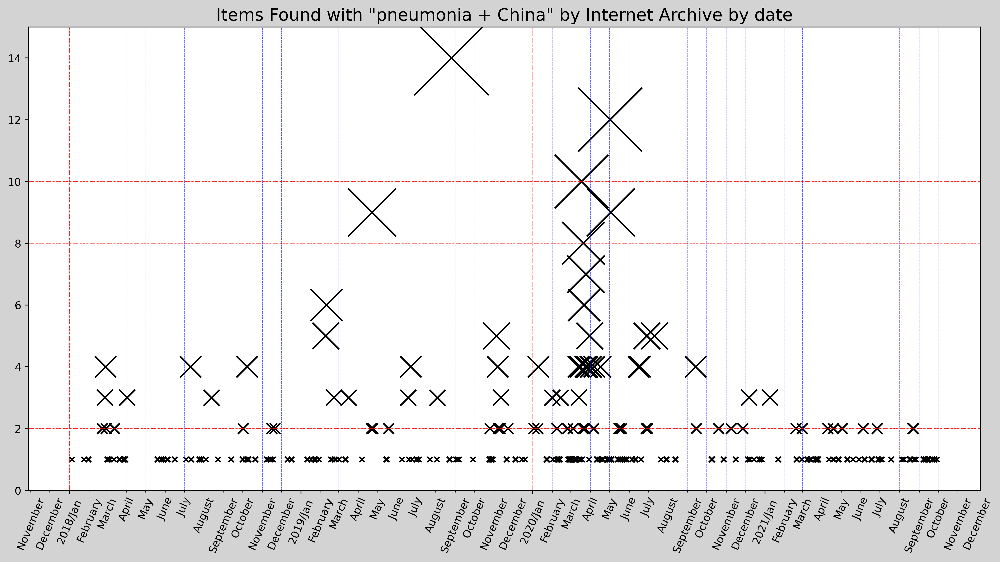

In [24]:
%matplotlib inline
x = df1.index
y = df1['Count']

fig= plt.figure(figsize=(16, 8), dpi=400,facecolor='lightgray')

plt.gca().xaxis.set_minor_formatter(mdates.DateFormatter('%B'))
plt.gca().xaxis.set_minor_locator(mdates.MonthLocator())
plt.gca().tick_params(axis="x", which="both", rotation=67)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y/%b'))
plt.gca().xaxis.set_major_locator(mdates.YearLocator())
plt.scatter(x,y,s=y*y*25,marker='x',color='k')
plt.gca().grid(which='major', color='r', linestyle='-.', linewidth=.3, alpha=1)  
plt.gca().grid(which='minor', color='b', linestyle='-.', linewidth=.2,alpha=.7)
plt.ylim(top=15,bottom=0)
plt.title('Items Found with "pneumonia + China" by Internet Archive by date',size=16)

plt.show()
plt.close()

In [ ]:

import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from celluloid import Camera

fig = plt.figure(figsize=(16, 9), dpi=300,facecolor='lightgray')
ax=  fig.gca()
ax.xaxis.set_minor_formatter(mdates.DateFormatter('%B'))
ax.xaxis.set_minor_locator(mdates.MonthLocator())
ax.tick_params(axis="x", which="both", rotation=67)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y/%b'))
ax.xaxis.set_major_locator(mdates.YearLocator())
ax.grid(which='major', color='r', linestyle='-.', linewidth=.3, alpha=1)  
ax.grid(which='minor', color='b', linestyle='-.', linewidth=.2,alpha=.7)
ax.set_ylim(top=100,bottom=0)

plt.title('Items Found with "Wuhan" by Internet Archive by date',size=16)

rows = []
a = 0
camera = Camera(fig)
for i,row in df1.iterrows():
    rows=df1[:i]
    ax.scatter(rows['Count'].index,rows['Count'],s=rows['Count']*4,marker='x',color='k')
    camera.snap()

anim = camera.animate(blit=False)

anim.save('scatter.gif',fps=60)

plt.show()
plt.close()